<a href="https://colab.research.google.com/github/jsansao/dlvc/blob/main/Licao16_TreinamentoYOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lição 16 - Treinamento do YOLOv5 para dataset próprio



Nessa lição, vamos mostrar como treinar o YOLOv5 para detectar objetos de um dataset próprio. 

Vamos usar o dataset das peças de Xadrez usado em lição anterior, fornecido pela Roboflow e hospedado no github. 

O dataset está no formato do YOLO, que difere dos formatos COCO e PASCAL VOC.  

# Passo 1: Instalação

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 10008, done.
remote: Total 10008 (delta 0), reused 0 (delta 0), pack-reused 10008
Receiving objects: 100% (10008/10008), 10.35 MiB | 7.92 MiB/s, done.
Resolving deltas: 100% (6938/6938), done.
/content/yolov5
     |████████████████████████████████| 596 kB 4.1 MB/s 
     |████████████████████████████████| 145 kB 4.1 MB/s 
     |████████████████████████████████| 178 kB 42.0 MB/s 
     |████████████████████████████████| 1.1 MB 41.4 MB/s 
     |████████████████████████████████| 67 kB 5.3 MB/s 
     |████████████████████████████████| 138 kB 47.9 MB/s 
     |████████████████████████████████| 62 kB 774 kB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.26.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0

# Passo 2: Download do dataset

In [2]:
!wget https://github.com/jsansao/ChessPiecesv23_YoloV5/archive/refs/heads/main.zip -O ChessPieces.zip
!unzip ChessPieces.zip -d /content/
!mv /content/ChessPiecesV23_YoloV5-main/* /content/

--2021-11-22 19:22:49--  https://github.com/jsansao/ChessPiecesv23_YoloV5/archive/refs/heads/main.zip
Resolving github.com (github.com)... 52.192.72.89
Connecting to github.com (github.com)|52.192.72.89|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/jsansao/ChessPiecesV23_YoloV5/zip/refs/heads/main [following]
--2021-11-22 19:22:50--  https://codeload.github.com/jsansao/ChessPiecesV23_YoloV5/zip/refs/heads/main
Resolving codeload.github.com (codeload.github.com)... 13.112.159.149
Connecting to codeload.github.com (codeload.github.com)|13.112.159.149|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘ChessPieces.zip’

ChessPieces.zip         [                <=> ]  77.11M  24.3MB/s    in 3.3s    

2021-11-22 19:22:54 (23.2 MB/s) - ‘ChessPieces.zip’ saved [80855882]

Archive:  ChessPieces.zip
40e7a8936666b780a8ad6f862dc057f2751d98cf
   creating: /content/ChessPiece

## Passo 3: Treinamento do modelo no YOLOv5

Podemos definir alguns parâmetros:

- **img:** tamanho da imagem de entrada
- **batch:** tamanho do lote
- **epochs:** Épocas de treinamento. (Note: often, 3000+ are common here!)
- **data:** Caminho do dataset
- **weights:** Inicialização dos pesos. No exemplo, usamos o modelo COCO pretreinado.
- **cache:** Faz cache das imagens para aceleração do processamento

In [3]:
!python train.py --img 416 --batch 16 --epochs 150 --data /content/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=150, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-103-g7a39803 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.

# Avaliação de desempenho do YOLOv5 


In [4]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

# Infererência com os pesos treinados: 

Roda a inferência no conteúdo do diretório `test/images/`


In [5]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source /content/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/test/images, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-103-g7a39803 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 213 layers, 7045186 parameters, 0 gradients, 15.9 GFLOPs
image 1/29 /content/test/images/0b47311f426ff926578c9d738d683e76_jpg.rf.0b55f43ac16aa65c889558d8ea757072.jpg: 288x416 1 white-bishop, Done. (0.027s)
image 2/29 /content/test/images/1c0060ef868bdc326ce5e6389cb6732f_jpg.rf.9ce88078ea356949f4ab7ad9cfdfc62d.jpg: 288x416 1 white-rook, Done. (0.026s)
image 3/29 /content/test/images/2f6fb003bb89cd401322a535acb42f65_jpg.rf.91ad9df05bd1f86bab67c8368ae5e

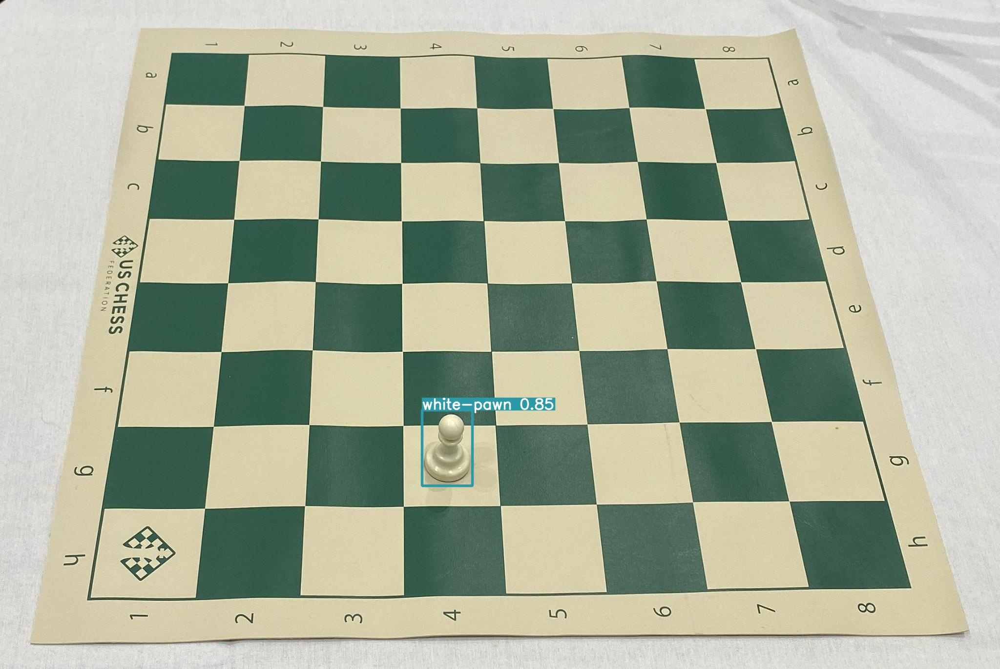

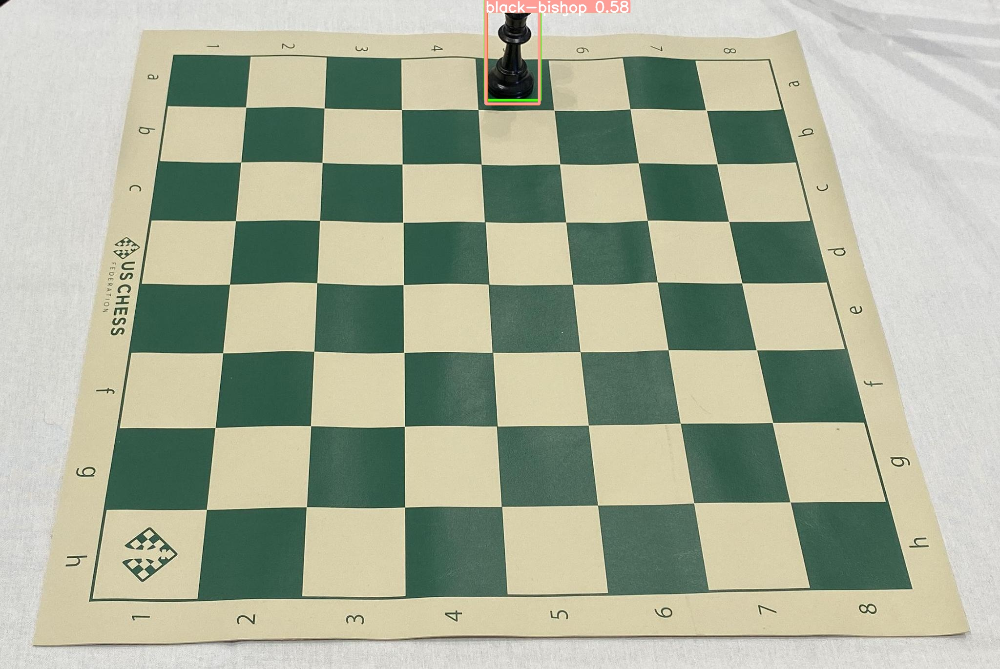

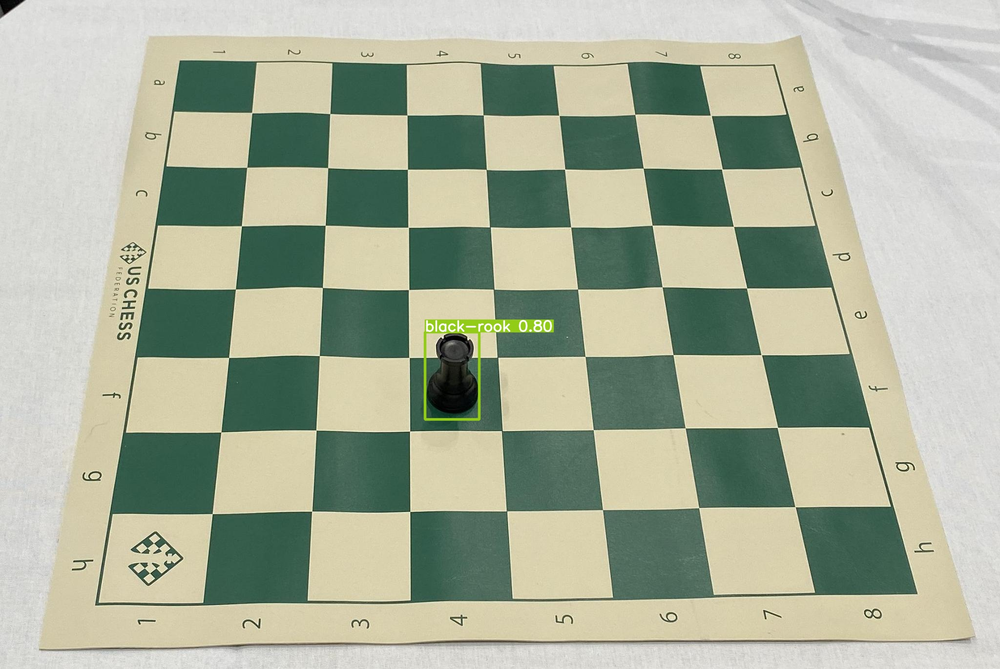

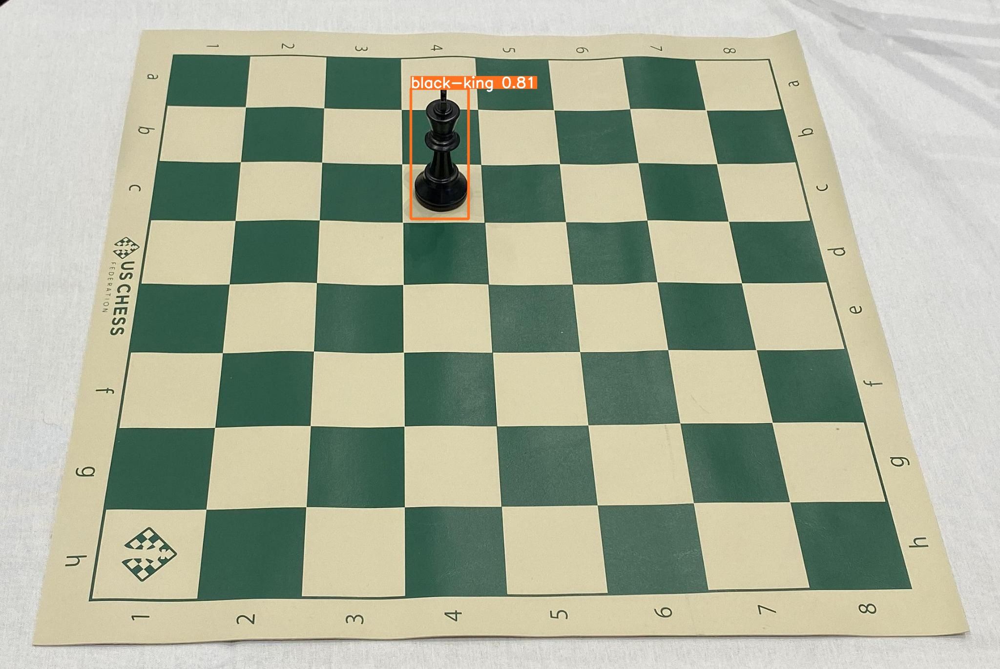

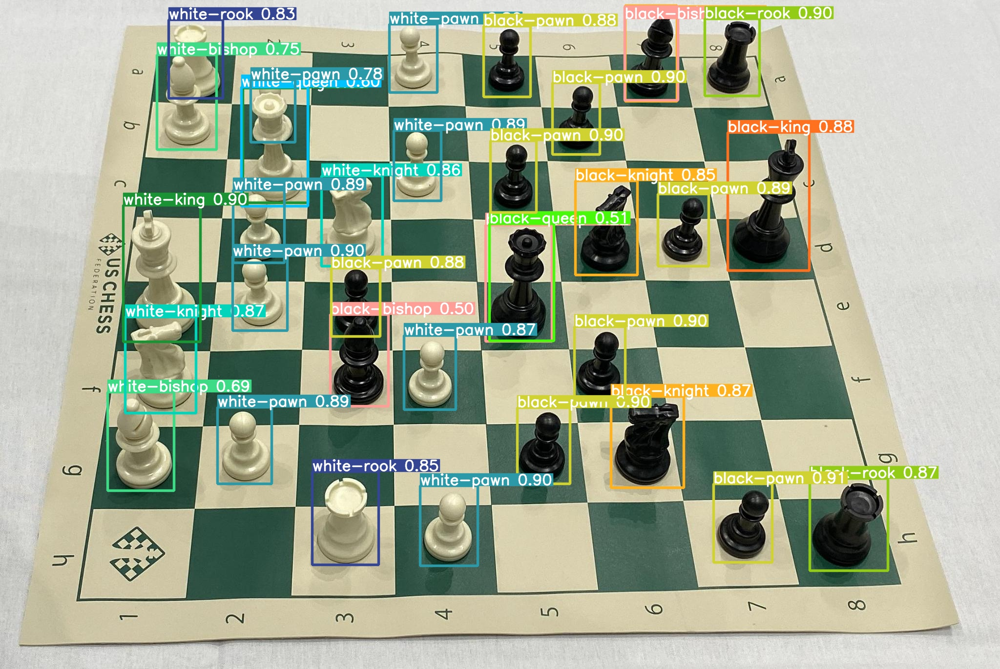

...

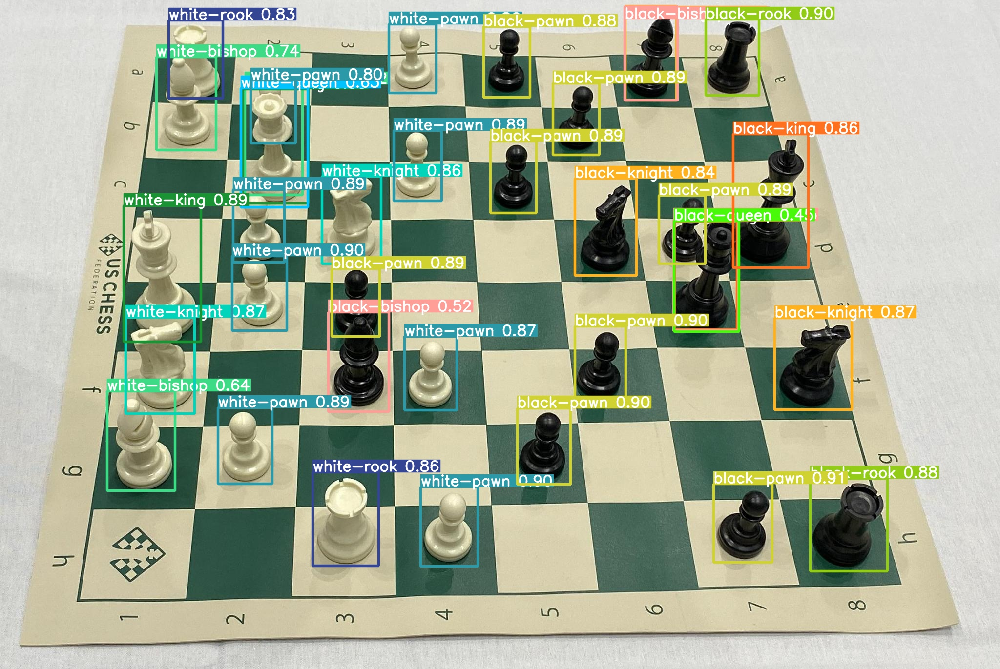

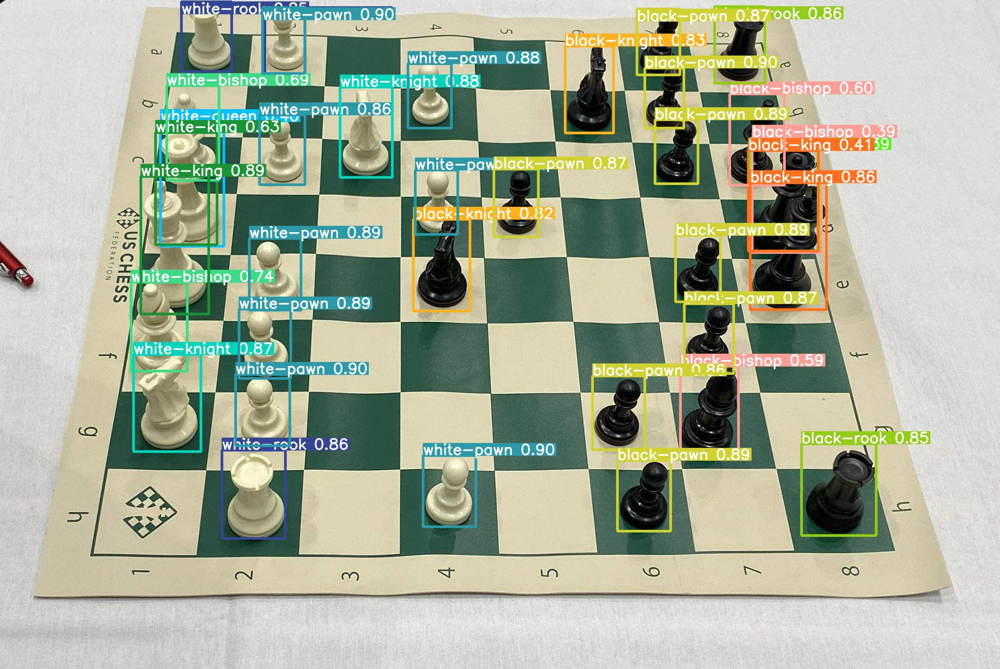

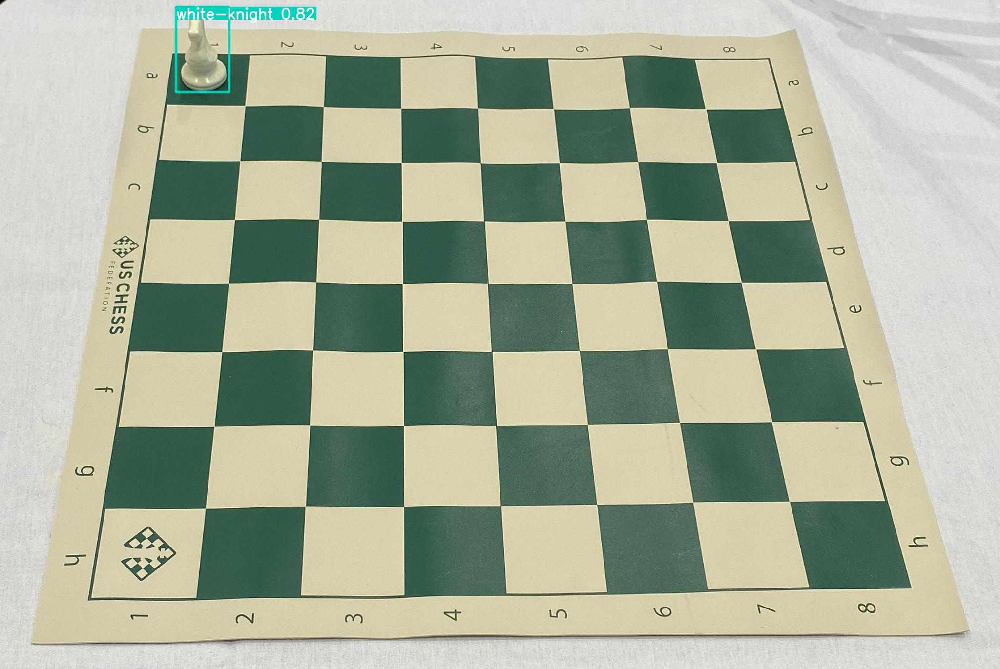

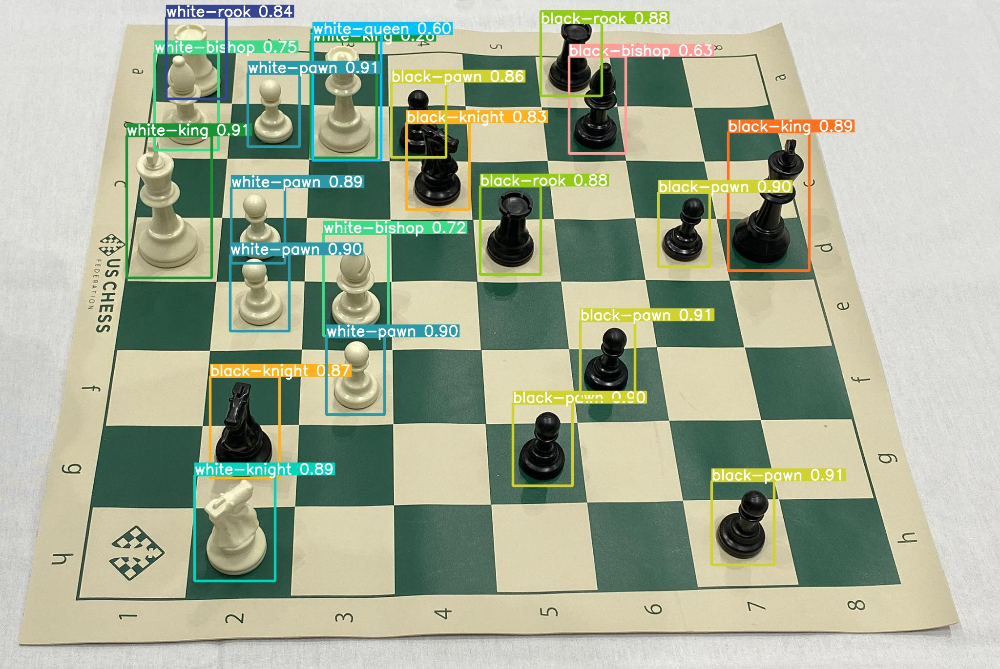

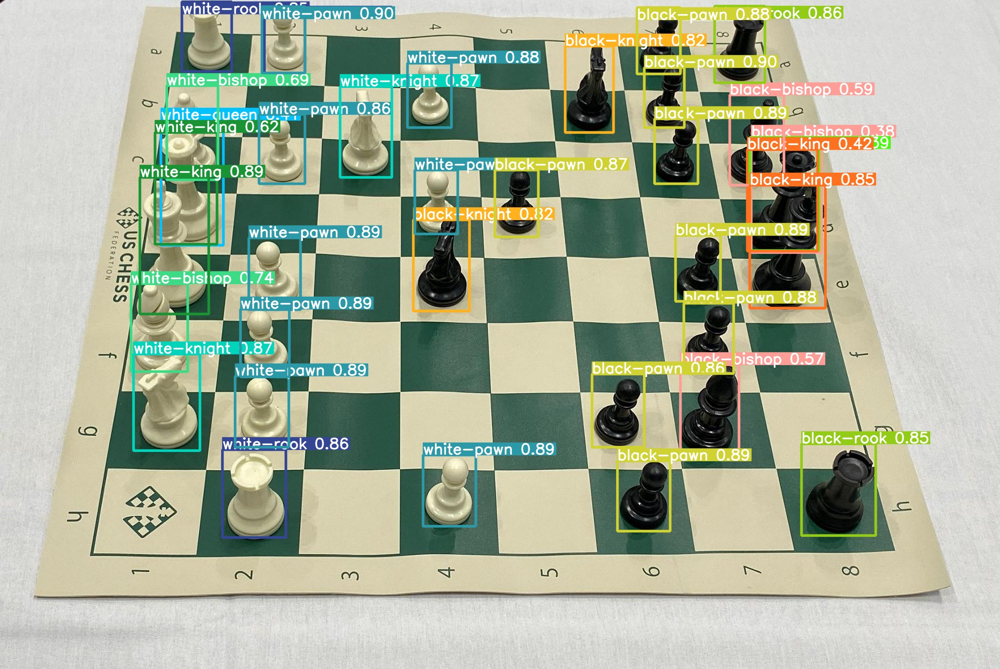

In [7]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")